In [1]:
%load_ext autoreload
%autoreload 2

import os, sys
from pathlib import Path
cwd = os.getcwd()

repo_name = 'ebm_wgan'
repo_path = os.path.join(cwd, '../ebm-wgan')
api_path = os.path.join(repo_path, 'api')
notebook_path = os.path.join(repo_path, 'notebook')
models_path = os.path.join(notebook_path, 'models/2d_gaussian')
models_path = '.'

sys.path.append(api_path)

In [2]:
sys.path.append('..')

In [3]:
import numpy as np
import sklearn.datasets
from sklearn.preprocessing import StandardScaler
import time
import random
from numpy import concatenate as concat
import pandas as pd

from matplotlib import pyplot as plt

import torch, torch.nn as nn
import torch.nn.functional as F

from torch.autograd import Variable
from torch import autograd
from torch.distributions import MultivariateNormal, Normal, Independent, Uniform

from paths import path_to_save
from utils import (prepare_25gaussian_data, 
                   prepare_swissroll_data, 
                   prepare_train_batches, 
                   sample_fake_data)
from models import (Generator_2d, 
                            Discriminator_2d, 
                            weights_init_1, 
                            weights_init_2)
from train import train_gan, Evolution

# from utils import visualize_fake_data_projection

import glob
import re
from mh_2d import *

In [4]:
import itertools

def prepare_25gaussian_data(BATCH_SIZE=1000, sigma=0.05):
    dataset = []
    means = np.array(list(itertools.product(np.arange(-2,3), repeat=2)))

    for i in range(BATCH_SIZE//25):
        for x in range(-2, 3):
            for y in range(-2, 3):
                point = np.random.randn(2)*sigma
                point[0] += x
                point[1] += y
                dataset.append(point)
    dataset = np.array(dataset, dtype=np.float32)
    np.random.shuffle(dataset)
    #dataset /= 2.828 # stdev
    return dataset, means, sigma 

In [5]:
torch.manual_seed(42)
np.random.seed(42)
random.seed(42)

train_dataset_size = 64000
n_test_pts = 10000
BATCH_SIZE = 32            
X_train, means, sigma = prepare_25gaussian_data(train_dataset_size, sigma=0.05)
stand_scaler = StandardScaler()
X_train = stand_scaler.fit_transform(X_train)
X_train_batches = torch.utils.data.DataLoader(torch.FloatTensor(X_train), batch_size=BATCH_SIZE) #prepare_train_batches(X_train, BATCH_SIZE) 

device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
n_dim = 2
G = Generator_2d(n_dim = n_dim, n_hidden = 100).to(device)

D = Discriminator_2d(n_hidden = 100, top_nonlin=nn.Sigmoid()).to(device)

In [6]:
lr = 1e-4
b1 = 0.5
b2 = 0.9

num_epochs = 350
num_epoch_for_save = 10
batch_size_sample = 1000

In [15]:
g_optimizer = torch.optim.Adam(G.parameters(), lr=lr, betas=(b1, b2), weight_decay=1e-5)
d_optimizer = torch.optim.Adam(D.parameters(), lr=lr, betas=(b1, b2), weight_decay=1e-5)

In [16]:
path_to_save = models_path

In [17]:
train_gan(X_train,
            X_train_batches, 
            G, g_optimizer, 
            D, d_optimizer,
            path_to_save,
            batch_size = BATCH_SIZE,
            device = device,
            num_epochs = num_epochs, 
            num_epoch_for_save = num_epoch_for_save,
            batch_size_sample = batch_size_sample)

Start epoch = 0


In [13]:
models_path = 'models'

In [17]:
n_calib_pts = 10 * BATCH_SIZE

In [50]:
def collect_evolution(X_train, 
                    means, 
                    sigma, 
                    models_path, 
                    device, 
                    batch_size_sample=10000):
    discriminator_regexp = os.path.join(models_path, "*_discriminator.pth")
    generator_regexp = os.path.join(models_path, "*_generator.pth")
    discriminator_name = list(sorted([f for f in glob.glob(discriminator_regexp)], key=lambda x: int(re.findall(r'\d+', x)[0])))
    generator_name = list(sorted([f for f in glob.glob(generator_regexp)], key=lambda x: int(re.findall(r'\d+', x)[0])))

    gan_evolution = Evolution(means=torch.FloatTensor(means).to(device), sigma=sigma)
    mh_gan_evolution = Evolution(means=torch.FloatTensor(means).to(device), sigma=sigma)

    for dn, gn in zip(discriminator_name, generator_name):
        d = re.sub(r'\.[^.]+', '', dn)
        print(f"Checkpoint: {d}")
        G.load_state_dict(torch.load(gn, map_location=device))
        D.load_state_dict(torch.load(dn, map_location=device))

        X_gen = G.sampling(batch_size_sample).detach().cpu().numpy()
        gan_evolution.invoke(torch.FloatTensor(stand_scaler.inverse_transform(X_gen)))

        n_calib_pts = 100 * BATCH_SIZE
        X_gen = mh_sample(X_train, G, D, device, n_calib_pts, batch_size=BATCH_SIZE)
        mh_gan_evolution.invoke(torch.FloatTensor(stand_scaler.inverse_transform(X_gen)))

    return  gan_evolution, mh_gan_evolution



In [51]:
gan_evolution, mh_gan_evolution = collect_evolution(X_train, means, sigma, models_path, device, batch_size_sample=1000)

mode_std, hqr, jsd = gan_evolution.mode_std, gan_evolution.high_quality_rate, gan_evolution.jsd
np.savez('evol', mode_std=mode_std, hqr=hqr, jsd=jsd)

mode_std, hqr, jsd = mh_gan_evolution.mode_std, mh_gan_evolution.high_quality_rate, mh_gan_evolution.jsd
np.savez('mh_evol', mode_std=mode_std, hqr=hqr, jsd=jsd)

Checkpoint: models/30_discriminator
using dump folder:
/home/evgeny/gans_sampling/25_gaussians/temp
image dumps...
max scores
base    0.951655


KeyboardInterrupt: 

In [71]:
evol = dict(np.load('evol.npz'))
mh_evol = dict(np.load('mh_evol.npz'))

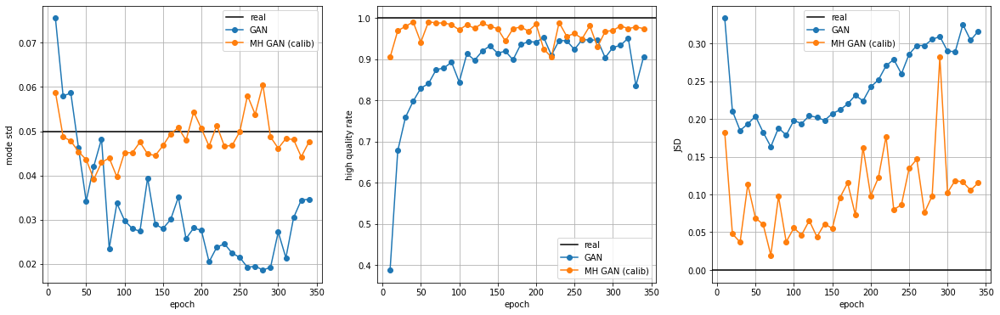

In [242]:
fig, axs = plt.subplots(ncols=3, nrows=1, figsize=(20, 6))


axs[0].axhline(sigma, label='real', color='black')
axs[0].set_xlabel('epoch')
axs[0].set_ylabel('mode std')

axs[1].axhline(1, label='real', color='black')
axs[1].set_xlabel('epoch')
axs[1].set_ylabel('high quality rate')

axs[2].axhline(0, label='real', color='black')
axs[2].set_xlabel('epoch')
axs[2].set_ylabel('JSD')

axs[0].plot(np.arange(1, len(mode_std)+1) * 10, evol['mode_std'], label='GAN', marker='o')
axs[1].plot(np.arange(1, len(mode_std)+1) * 10, evol['hqr'], label='GAN', marker='o')
axs[2].plot(np.arange(1, len(mode_std)+1) * 10, evol['jsd'], label='GAN', marker='o')


axs[0].plot(np.arange(1, len(mode_std)+1) * 10, mh_evol['mode_std'], label='MH GAN (calib)', marker='o')
axs[1].plot(np.arange(1, len(mode_std)+1) * 10, mh_evol['hqr'], label='MH GAN (calib)', marker='o')
axs[2].plot(np.arange(1, len(mode_std)+1) * 10, mh_evol['jsd'], label='MH GAN (calib)', marker='o')

for ax in axs:
    ax.grid()
    ax.legend()
    
plt.savefig('plots/evolution/evolution_plot.png')
plt.show()

In [251]:
import datetime

def visualize_fake_data_projection(fake_data, X_train, path_to_save, proj_1, proj_2, 
                                   title,
                                   mode):
    fake_data_proj = fake_data[:, [proj_1, proj_2]]
    X_train_proj = X_train[:, [proj_1, proj_2]]

    plt.figure(figsize=(8, 8))
    # plt.xlim(-2., 2.)
    # plt.ylim(-2., 2.)
    plt.title(title, fontsize=20)
    X_train_proj = X_train[:, [proj_1, proj_2]]


    plt.scatter(X_train_proj[:, 0], X_train_proj[:, 1], alpha=0.5, color='gray',
                marker='o', label = 'training samples')
    plt.scatter(fake_data_proj[:, 0], fake_data_proj[:, 1], alpha=0.5, color='blue',
                marker='o', label = 'samples by G')
    plt.xlabel(f"proj ind = {proj_1 + 1}")
    plt.ylabel(f"proj ind = {proj_2 + 1}")
    plt.legend()
    plt.grid(True)
    if path_to_save is not None:
       cur_time = datetime.datetime.now().strftime('%Y_%m_%d-%H_%M_%S')
       plot_name = cur_time + f"_wgan_sampling_" + mode + f"_proj1_{proj_1}_proj2_{proj_2}.png"
       path_to_plot = os.path.join(path_to_save, plot_name)
       plt.savefig(path_to_plot)

    else:
       plt.show()

In [260]:
X_ = G.sampling(batch_size=10000).detach().cpu().numpy()

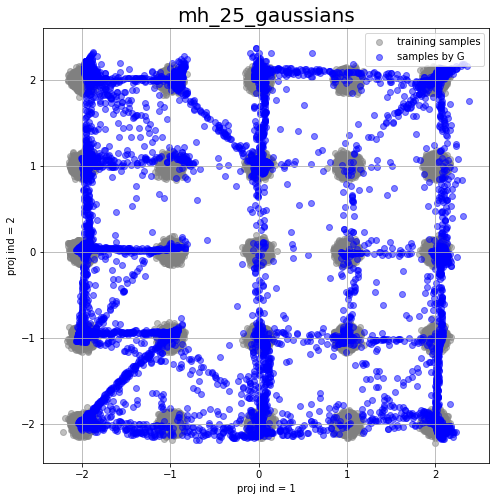

In [261]:
visualize_fake_data_projection(stand_scaler.inverse_transform(X_), stand_scaler.inverse_transform(X_train), '.', 0, 1, 'mh_25_gaussians', '')

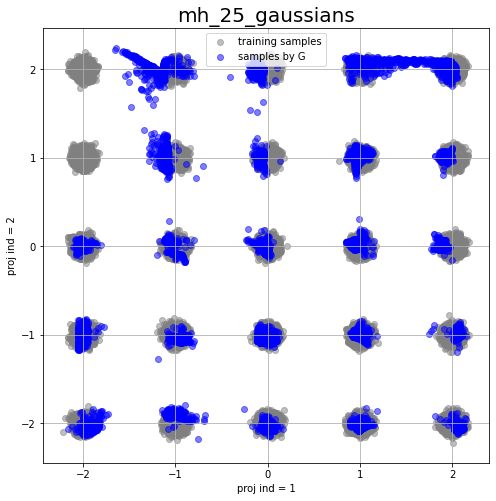

In [56]:
visualize_fake_data_projection(stand_scaler.inverse_transform(X), stand_scaler.inverse_transform(X_train), '.', 0, 1, 'mh_25_gaussians', '')

In [50]:
num_points = 700
a = torch.linspace(-3.0, 3.0, num_points)
b = torch.linspace(-3.0, 3.0, num_points)
x_t = a.view(-1, 1).repeat(1, b.size(0))
y_t = b.view(1, -1).repeat(a.size(0), 1)

In [51]:
x_t_batch = x_t.view(-1 , 1)
y_t_batch = y_t.view(-1 , 1)
batch = torch.zeros((x_t_batch.shape[0], 2))
batch[:, 0] = x_t_batch[:, 0]
batch[:, 1] = y_t_batch[:, 0]

In [267]:
import glob
discriminator_regexp = os.path.join(models_path, "*_discriminator.pth")
generator_regexp = os.path.join(models_path, "*_generator.pth")
discriminator_name = list(sorted([f for f in glob.glob(discriminator_regexp)], key=lambda x: int(re.findall(r'\d+', x)[0])))[-1]
generator_name = list(sorted([f for f in glob.glob(generator_regexp)], key=lambda x: int(re.findall(r'\d+', x)[0])))[-1]

G.load_state_dict(torch.load(generator_name, map_location=device))
D.load_state_dict(torch.load(discriminator_name, map_location=device))

<All keys matched successfully>

In [268]:
list(sorted([f for f in glob.glob(discriminator_regexp)], key=lambda x: int(re.findall(r'\d+', x)[0])))[3]

'models/30_discriminator.pth'

In [269]:
discr_batch = D(batch.to(device))
heatmap = discr_batch[:, 0].view((num_points, num_points)).detach().cpu().numpy()

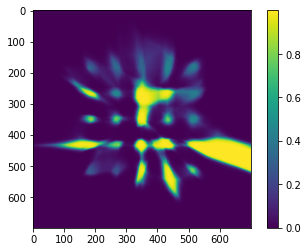

In [271]:
import matplotlib.pyplot as plt
import numpy as np


def heatmap2d(arr: np.ndarray):
    plt.imshow(arr, cmap='viridis')
    plt.colorbar()


heatmap2d(heatmap)

plt.savefig('plots/heatmap/heat.png')
plt.show()